## version8 : 10/26 –

- ver7のモデルを修正したバージョン

### Libraries

In [55]:
import os
import sys
import math
import time
import yaml
import errno
import random
import datetime
import numpy as np
import pandas as pd
from tqdm import trange
from tqdm.notebook import tqdm

from sklearn.metrics import mean_squared_error, mean_absolute_error

import torch
import torch.nn as nn
from torch import optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

import matplotlib.pyplot as plt
import plotly.graph_objects as go

# set random seed
fix_seed = 1111
np.random.seed(fix_seed)
torch.manual_seed(fix_seed)

# set device 
device = torch.device('mps' if torch.backends.mps.is_available() else 'cpu')
print(device)

mps


### Import parameters and data

In [56]:
# load parameters
with open('/Users/koki/PycharmProjects/MasterThesis/params/config_lstm_seq2seq.yml', 'r') as yml:
    yaml_data = yaml.safe_load(yml)

In [57]:
# import data
df = pd.read_csv('/Users/koki/PycharmProjects/MasterThesis/data/preprocessed/201601to202309_10areas_for_analysis.csv')
df['datetime'] = pd.to_datetime(df['datetime'])
df = df.set_index('datetime')

# covid dummy
covid_1 = pd.date_range(start='2020-03-01', end='2020-05-30 21:00', freq='3h')  # 第1波
covid_2 = pd.date_range(start='2020-11-01', end='2021-04-30 21:00', freq='3h')  # 第3波, 第4波
covid_3 = pd.date_range(start='2021-07-01', end='2021-09-30 21:00', freq='3h')  # 第5波
covid_4 = pd.date_range(start='2021-12-01', end='2022-03-31 21:00', freq='3h')  # 第6波(オミクロン株の拡大)
covid = covid_1.union(covid_2).union(covid_3).union(covid_4)
df['covid'] = df.index.map(lambda d: int(d in covid))

In [58]:
df.columns

Index(['渋谷駅_total', '新宿駅_total', '町田駅_total', '川崎駅_total', '立川駅_total',
       '八王子駅_total', '北千住駅_total', '東京駅_total', '赤羽駅_total', '自由が丘駅_total',
       'official_holiday', 'unofficial_holiday', 'month_1', 'month_10',
       'month_11', 'month_12', 'month_2', 'month_3', 'month_4', 'month_5',
       'month_6', 'month_7', 'month_8', 'month_9', 'hour_0', 'hour_12',
       'hour_15', 'hour_18', 'hour_21', 'hour_3', 'hour_6', 'hour_9',
       'dow_Fri', 'dow_Mon', 'dow_Sat', 'dow_Sun', 'dow_Thu', 'dow_Tue',
       'dow_Wed', 'heavy_rain', '東京_rainfall', '東京_temperature',
       '東京_dew_point_humidity', '東京_humidity', '東京_windspeed_value',
       '東京_sunshine_hours', '東京_global_solar_radiation', '東京_snowfall',
       '東京_weather_みぞれ', '東京_weather_快晴', '東京_weather_晴れ', '東京_weather_曇',
       '東京_weather_氷あられ', '東京_weather_薄曇', '東京_weather_雨', '東京_weather_雪',
       '東京_weather_雷電', '八王子_rainfall', '八王子_temperature',
       '八王子_windspeed_value', '八王子_sunshine_hours', 'N225_Close',
       'C

In [59]:
df = df.drop(columns=[
                      'month_1', 'month_10', 'month_11', 'month_12', 'month_2', 'month_3', 
                      'month_4', 'month_5', 'month_6', 'month_7', 'month_8', 'month_9',
                      'hour_0', 'hour_12', 'hour_15', 'hour_18', 'hour_21', 'hour_3', 'hour_6', 'hour_9',
                      'dow_Fri', 'dow_Mon', 'dow_Sat', 'dow_Sun', 'dow_Thu', 'dow_Tue', 'dow_Wed'
                    ])
df

,渋谷駅_total,新宿駅_total,町田駅_total,川崎駅_total,立川駅_total,八王子駅_total,北千住駅_total,東京駅_total,赤羽駅_total,自由が丘駅_total,...,八王子_rainfall,八王子_temperature,八王子_windspeed_value,八王子_sunshine_hours,N225_Close,Cases_Tokyo,東京_緊急事態,東京_まん防,東京_weather_霧雨,covid
datetime,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,35355,12141,14725,17493,10177,12231,11088,5839,13977,9576,...,0.0,1.5,1.8,0.0,18450.98,0.0,0,0,0,0
2016-01-01 03:00:00,28498,12368,14351,17447,9992,10735,11248,6329,14161,9241,...,0.0,1.1,4.1,0.0,18450.98,0.0,0,0,0,0
2016-01-01 06:00:00,17156,11814,13452,17407,9351,10595,10763,13130,13327,8840,...,0.0,-1.1,1.7,0.0,18450.98,0.0,0,0,0,0
2016-01-01 09:00:00,17727,18039,14696,24128,12199,11015,11835,18117,14174,9030,...,0.0,5.2,1.2,1.0,18450.98,0.0,0,0,0,0
2016-01-01 12:00:00,26222,24975,17675,31771,16030,12370,12966,23981,15539,10533,...,0.0,10.8,2.0,1.0,18450.98,0.0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-30 09:00:00,35347,42090,21798,28723,25356,17428,17618,37380,20538,15806,...,0.0,24.7,1.8,0.0,31857.62,0.0,0,0,0,0
2023-09-30 12:00:00,84314,92850,36892,44786,47068,24358,27022,71237,26053,25193,...,0.0,24.0,0.8,0.0,31857.62,0.0,0,0,0,0
2023-09-30 15:00:00,110158,113744,41491,49685,52116,25661,29211,78514,29550,27711,...,0.0,26.4,2.7,0.0,31857.62,0.0,0,0,0,0


In [60]:
df.columns

Index(['渋谷駅_total', '新宿駅_total', '町田駅_total', '川崎駅_total', '立川駅_total',
       '八王子駅_total', '北千住駅_total', '東京駅_total', '赤羽駅_total', '自由が丘駅_total',
       'official_holiday', 'unofficial_holiday', 'heavy_rain', '東京_rainfall',
       '東京_temperature', '東京_dew_point_humidity', '東京_humidity',
       '東京_windspeed_value', '東京_sunshine_hours', '東京_global_solar_radiation',
       '東京_snowfall', '東京_weather_みぞれ', '東京_weather_快晴', '東京_weather_晴れ',
       '東京_weather_曇', '東京_weather_氷あられ', '東京_weather_薄曇', '東京_weather_雨',
       '東京_weather_雪', '東京_weather_雷電', '八王子_rainfall', '八王子_temperature',
       '八王子_windspeed_value', '八王子_sunshine_hours', 'N225_Close',
       'Cases_Tokyo', '東京_緊急事態', '東京_まん防', '東京_weather_霧雨', 'covid'],
      dtype='object')

### Define dataset

In [61]:
class SequenceDataset(Dataset):
    def __init__(self, dataframe, seq_len_src=56, seq_len_tgt=8, lag_len=1):
        self.seq_len_src = seq_len_src
        self.lag_len = lag_len
        self.seq_len_tgt = seq_len_tgt
        self.df = torch.tensor(dataframe.values).float()
        self.len = math.floor((len(self.df) - self.seq_len_src - self.seq_len_tgt) / self.lag_len) + 1

    def __len__(self):
        return self.len

    def __getitem__(self, i):
        if type(i) == slice:
            raise Exception('Exception: Expected int, inputted slice!')
            
        X = self.df[i*self.lag_len:i*self.lag_len+self.seq_len_src]
        Y = self.df[i*self.lag_len+self.seq_len_src:i*self.lag_len+self.seq_len_src+self.seq_len_tgt]
        
        return X, Y
    
    def input_size(self):
        return self.df.shape[1]

### Split data

In [62]:
batch_size = yaml_data['dataset']['batch_size']
seq_len_src = yaml_data['dataset']['seq_len_src']
seq_len_tgt = yaml_data['dataset']['seq_len_tgt']
lag_len = yaml_data['dataset']['lag_len']

# set start dates and end dates
train_start = yaml_data['dataset']['train_start']
train_end = yaml_data['dataset']['train_end']
valid_start = yaml_data['dataset']['valid_start']
valid_end = yaml_data['dataset']['valid_end']
test_start = yaml_data['dataset']['test_start']
test_end = yaml_data['dataset']['test_end']

# split df into train, valid and test data
df_train = df.loc[train_start:train_end].copy()
df_valid = df.loc[valid_start:valid_end].copy()
df_test = df.loc[test_start:test_end].copy()

# # choose hours to use
# time_list = yaml_data['dataset']['time_list']
# if time_list != 'all':
#     df_valid = df_valid.loc[df_valid.index.hour.isin(time_list)]
#     df_test = df_test.loc[df_test.index.hour.isin(time_list)]

# df for prediction
df_valid_for_pred = pd.concat([df_train.iloc[-seq_len_src:, :], df_valid])  # valid_dataの1期目から予測するために、前日もテストデータに含める。
df_test_for_pred = pd.concat([df_valid.iloc[-seq_len_src:, :], df_test])  # test_dataの1期目から予測するために、前日もテストデータに含める。

# print the fraction of each dataset
print("Train set fraction: {:.3f}%".format(len(df_train)/len(df)*100))
print("Valid set fraction: {:.3f}%".format(len(df_valid)/len(df)*100))
print("Test set fraction: {:.3f}%".format(len(df_test)/len(df)*100))

Train set fraction: 77.456%
Valid set fraction: 12.898%
Test set fraction: 9.647%


### Set dataloader

In [63]:
# create dataset
train_dataset = SequenceDataset(df_train, seq_len_src=56, seq_len_tgt=8, lag_len=1)
valid_dataset = SequenceDataset(df_valid, seq_len_src=seq_len_src, seq_len_tgt=seq_len_tgt, lag_len=lag_len)
test_dataset = SequenceDataset(df_test, seq_len_src=seq_len_src, seq_len_tgt=seq_len_tgt, lag_len=lag_len)

# dataset for prediction
valid_dataset_for_pred = SequenceDataset(df_valid_for_pred, seq_len_src=seq_len_src, seq_len_tgt=seq_len_tgt, lag_len=lag_len)
test_dataset_for_pred = SequenceDataset(df_test_for_pred, seq_len_src=seq_len_src, seq_len_tgt=seq_len_tgt, lag_len=lag_len)

print("Length of each dataset:")
print("    Train:{}, Valid:{}, Test:{}".format(len(train_dataset), len(valid_dataset), len(test_dataset)))

# create dataloader
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=False, num_workers=0, pin_memory=True)
# valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, drop_last=False, num_workers=0, pin_memory=True)
# test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, drop_last=False, num_workers=0, pin_memory=True)

# check the shape of a batch
X, y = next(iter(train_loader))
print("Features shape:", X.shape)  # [batch size, sequence length, number of features]
print("Target shape:", y.shape)

Length of each dataset:
    Train:17473, Valid:358, Test:266
Features shape: torch.Size([8, 56, 40])
Target shape: torch.Size([8, 8, 40])


### Define LSTM seq2seq

In [64]:
class lstm_seq2seq(nn.Module):
    ''' 
    train LSTM encoder-decoder and make predictions
    モデル1：全変数をLSTMに入力し、二層の線型結合層に通して予測値を出力
    '''
    
    def __init__(self, num_features, hidden_size, num_layers, dropout, batch_size, num_features_pred):

        '''
        : param input_size:     the number of expected features in the input X
        : param hidden_size:    the number of features in the hidden state h
        '''

        super(lstm_seq2seq, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.batch_size= batch_size
        self.num_features_pred = num_features_pred
        
        # define LSTM layer
        self.lstm = nn.LSTM(input_size = num_features, hidden_size = hidden_size, num_layers = num_layers, batch_first=True, dropout = dropout)
        # define fc layer
        self.linear = nn.Linear(hidden_size, num_features)
        self.linear2 = nn.Linear(num_features, num_features_pred)
        # define relu
        self.relu = nn.ReLU()
        
    def encoder(self, src):
        '''
        : param src:                   input of shape (batch_size, seq_len, input_size)
        : return lstm_out, hidden:     lstm_out gives all the hidden states in the sequence;
        :                              hidden gives the hidden state and cell state for the last
        :                              element in the sequence 
        '''
        h0 = None
        lstm_out, (h,c) = self.lstm(src, h0)
        
        return (h, c)
    
    def decoder(self, src, encoder_hidden_states):
        '''        
        : param src:                        should be 3D (batch_size, seq_len, input_size)
        : param encoder_hidden_states:      hidden states; tuple
        : return output, hidden:            output gives all the hidden states in the sequence;
        :                                   hidden gives the hidden state and cell state for the last
        :                                   element in the sequence; tuple
        '''
        
        lstm_out, (h, c) = self.lstm(src, encoder_hidden_states)
        output = self.linear(lstm_out)
        output = self.relu(output)
        output = self.linear2(output)
        
        return output, (h, c)
    
    def forward(self, src, tgt):
        '''
        : param src:    input tensor with shape (batch_size, seq_len,  number features); PyTorch tensor    
        : param tgt:    target tensor with shape (batch_size, seq_len, number features); PyTorch tensor
        '''
        
        encoder_hidden = self.encoder(src)  # only encoder_hidden is used
        decoder_output, decoder_hidden = self.decoder(tgt, encoder_hidden)  # decoder_output.shape = [batch_size, seq_len, num_features] 

        return decoder_output

### Define training, validation and prediction

In [65]:
def train(model, data_loader, num_features_pred):
    total_loss = []
    for n_batches, (src, tgt) in enumerate(data_loader):
        src = src.to(device)
        tgt = tgt.to(device)
        
        # target for decoder
        input_tgt = torch.cat((src[:,-1:,:], tgt[:, :-1, :]), dim=1)
        
        # zero the gradient
        optimizer.zero_grad()
        
        output = model(src=src, tgt=input_tgt)

        # compute the loss
        loss = criterion(output[:,:,0:num_features_pred], tgt[:,:,0:num_features_pred])

        total_loss.append(loss.cpu().detach())

        # backpropagation
        loss.backward()
        optimizer.step()
    
    # change learning rate
    scheduler.step()
    
    # return loss for epoch 
    return np.average(total_loss)


def predict(model, dataset, num_features_pred):
    model.eval()
    with torch.no_grad():
        all_outputs = torch.Tensor().to(device)
        for i in tqdm(range(len(dataset))):
            src = dataset[i][0].to(device)
            tgt = dataset[i][1].to(device)

            src = src.unsqueeze(0)
            tgt = tgt.unsqueeze(0)

            encoder_hidden = model.encoder(src)

            # initialize tensor for predictions
            outputs = torch.Tensor().to(device)

            # input for decoder
            decoder_input = src[:, -1:, :]
            decoder_hidden = encoder_hidden

            # predict recursively
            for t in range(tgt.shape[1]):
                decoder_output, decoder_hidden = model.decoder(decoder_input, decoder_hidden)  # decoder_output.shape = [batch_size, 1(seq_len), num_features]
                outputs = torch.cat((outputs, decoder_output[:, -1, :]), dim=0)

                # decoder input at the next period = (location output from prediction) + (acurate dummy input from test data)
                decoder_input = torch.cat((decoder_output[:, :, 0:num_features_pred], tgt[:, t:t+1, num_features_pred:]), dim=2)

            all_outputs = torch.cat([all_outputs, outputs], dim=0)

    return all_outputs[:, :num_features_pred].to('cpu').detach().numpy()

### Define parameters

In [66]:
num_features = df.shape[1]
hidden_size = yaml_data['model']['hidden_size']
num_layers = yaml_data['model']['num_layers']
dropout = yaml_data['model']['dropout']
num_features_pred = yaml_data['training']['num_features_pred']
n_epochs = yaml_data['training']['n_epochs']
learning_rate = yaml_data['training']['learning_rate']
milestones = yaml_data['training']['milestones']
gamma = yaml_data['training']['gamma']

model = lstm_seq2seq(num_features = num_features, 
                     hidden_size = hidden_size, 
                     num_layers = num_layers, 
                     dropout = dropout,
                     batch_size=batch_size,
                     num_features_pred=num_features_pred).to(device)

optimizer = optim.Adam(model.parameters(), lr = learning_rate)
# scheduler = optim.lr_scheduler.MultiStepLR(optimizer, milestones=[15, 30], gamma=0.1)
scheduler = optim.lr_scheduler.MultiStepLR(optimizer, milestones=milestones, gamma=gamma)
criterion = nn.MSELoss().to(device)

### Training

In [67]:
start = time.time()
train_losses = []
# n_epochs = 20
with trange(n_epochs) as tr:
    for it in tr:
        # train
        loss_train = train(model=model, data_loader=train_loader, num_features_pred=num_features_pred)
        # convert to RMSE
        loss_train = math.sqrt(loss_train)
        # append epoch loss
        train_losses.append(loss_train)
        # progress bar 
        tr.set_postfix(Train_loss="{0:.3f}".format(loss_train))

# calculate execution time        
end = time.time()
t = math.floor(end-start)
elapsed_hour = t // 3600
elapsed_minute = (t % 3600) // 60
elapsed_second = (t % 3600 % 60)
elapsed_time = str(elapsed_hour).zfill(2) + ":" + str(elapsed_minute).zfill(2) + ":" + str(elapsed_second).zfill(2)

100%|█████████████████████████████████████████████████████████████████████████████| 40/40 [26:43<00:00, 40.09s/it, Train_loss=5705.001]


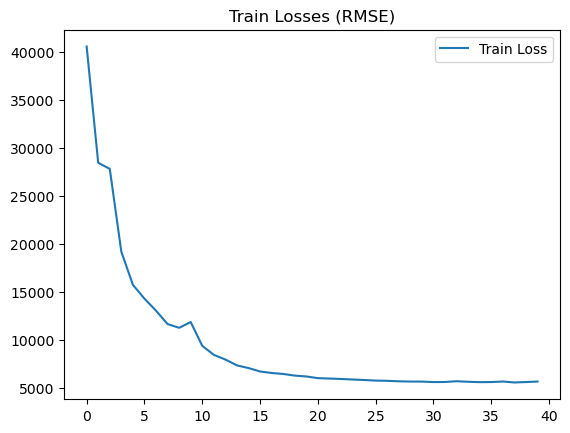

In [68]:
plt.plot(train_losses, label='Train Loss')
plt.title('Train Losses (RMSE)')
plt.legend()
plt.show()

In [69]:
# メモリー不足でkernelが切れたとき用
torch.save(model, '/Users/koki/PycharmProjects/MasterThesis/tmp/tmp_model.pth')
model = torch.load('/Users/koki/PycharmProjects/MasterThesis/tmp/tmp_model.pth')

### (Load a past model)

In [70]:
'''
This code is used only for loading the model and checking its prediction.
'''
# # set name of the model
# model_num = 5
# # load the model and its loss
# model = torch.load('/Users/koki/PycharmProjects/MasterThesis/models/model_' + str(model_num).zfill(2) + '.pth')
# loss = pd.read_excel('/Users/koki/PycharmProjects/MasterThesis/data/results.xlsx', sheet_name='train_losses', usecols=[model_num-1])
# train_losses = loss.iloc[:,0].to_list()

'\nThis code is used only for loading the model and checking its prediction.\n'

In [71]:
# torch.save(model.to('cpu').state_dict(), '/Users/koki/PycharmProjects/MasterThesis/model_40_for_serena.pth')
# torch.save(model.to('cpu'), '/Users/koki/PycharmProjects/MasterThesis/model_40_for_serena2.pth')
# model = torch.load('/Users/koki/PycharmProjects/MasterThesis/model_40_for_serena2.pth').to(device)

### Predict

In [72]:
num_features_pred = yaml_data['training']['num_features_pred']

# make y_pred df
pred_val = predict(model = model, dataset = valid_dataset_for_pred, num_features_pred = num_features_pred)
y_pred_val = pd.DataFrame(pred_val, columns=df.columns[:num_features_pred], index=df_valid.index).add_prefix('pred_')

  0%|          | 0/365 [00:00<?, ?it/s]

### Calculate RMSE and MAE (predicted values and actual values)

In [73]:
rmse, mae = {}, {}
for i in range(y_pred_val.shape[1]):
    rmse[df.columns[i]] = mean_squared_error(df_valid.iloc[:,i], y_pred_val.iloc[:,i], squared=False)
    mae[df.columns[i]] = mean_absolute_error(df_valid.iloc[:,i], y_pred_val.iloc[:,i])

rmse_pre_actu = pd.Series(rmse)
mae_pre_actu = pd.Series(mae)

print('------------RMSE------------')
print(rmse_pre_actu)
print('Average :', np.mean(rmse_pre_actu))
print('------------MAE-------------')
print(mae_pre_actu)
print('Average :', np.mean(mae_pre_actu))

------------RMSE------------
渋谷駅_total      13815.047775
新宿駅_total      16166.546680
町田駅_total       2359.802396
川崎駅_total       2941.735126
立川駅_total       4964.245602
八王子駅_total      1741.019802
北千住駅_total      1989.295881
東京駅_total      23259.570077
赤羽駅_total       2368.637302
自由が丘駅_total     1560.197533
dtype: float64
Average : 7116.60981729429
------------MAE-------------
渋谷駅_total       9973.730799
新宿駅_total      11244.749317
町田駅_total       1645.734646
川崎駅_total       2040.458770
立川駅_total       3553.208359
八王子駅_total      1366.484525
北千住駅_total      1457.617247
東京駅_total      15342.244118
赤羽駅_total       1658.989304
自由が丘駅_total     1049.281714
dtype: float64
Average : 4933.249879808818


In [74]:
def plot_population(y_true, y_pred, flag='plot', anomaly_datetime=None, anomaly_next_hours=None):
    # plot with plotly     
    for i in tqdm(range(y_pred.shape[1])):
        fig = go.Figure()
        fig.add_trace(go.Scatter(x=y_true.index, y=y_true.iloc[:, i], name=y_true.columns[i]))
        fig.add_trace(go.Scatter(x=y_pred.index, y=y_pred.iloc[:, i], name=y_pred.columns[i]))

        fig.update_xaxes(title="Date",showgrid=False)
        fig.update_yaxes(title="Population", showgrid=False)
        fig.update_layout(legend=dict(x=0.99,
                                  y=0.99,
                                  xanchor='right',
                                  yanchor='top',
                                  orientation='h',
                                  ),
                          hovermode='x unified',
                          title=dict(text=y_true.columns[i],
                                     font=dict(size=20, color='grey'),
                                     xref='paper', # container or paper
                                     x=0.5,
                                     y=0.85,
                                     xanchor='center'
                                    )
                         )

        if flag == 'anomaly_detection_tokyo':
            for t, next_t in zip(anomaly_datetime, anomaly_next_hours): 
                fig.add_vrect(
                            x0=t,
                            x1=next_t,
                            fillcolor='pink',
                            opacity=0.9,
                            line_width=0,
                            layer='below'
                            )
        
        elif flag == 'anomaly_detection':
            for t, next_t in zip(anomaly_datetime[i], anomaly_next_hours[i]): 
                fig.add_vrect(
                            x0=t,
                            x1=next_t,
                            fillcolor='pink',
                            opacity=0.9,
                            line_width=0,
                            layer='below'
                            )
        
        fig.show()

  0%|          | 0/10 [00:00<?, ?it/s]

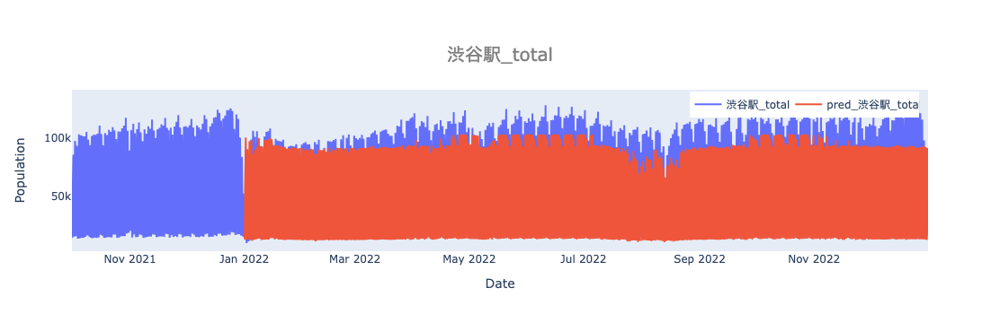

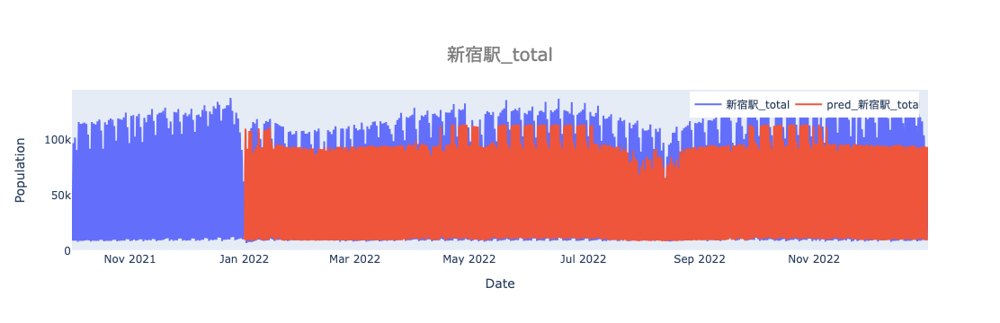

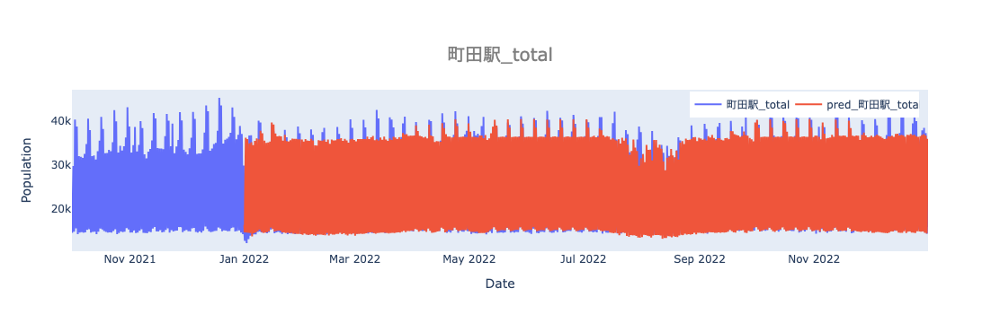

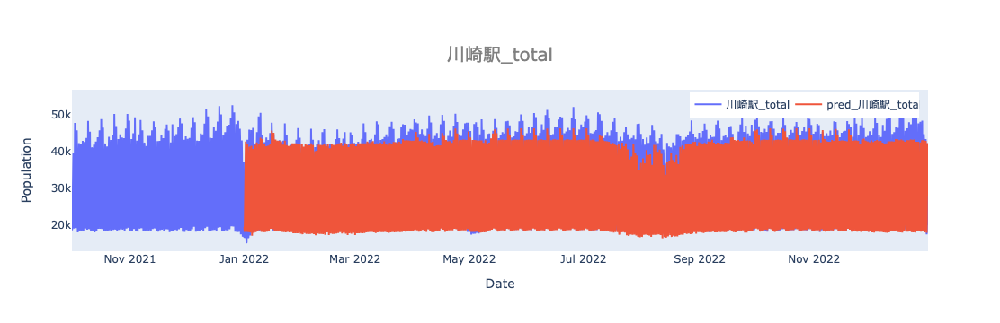

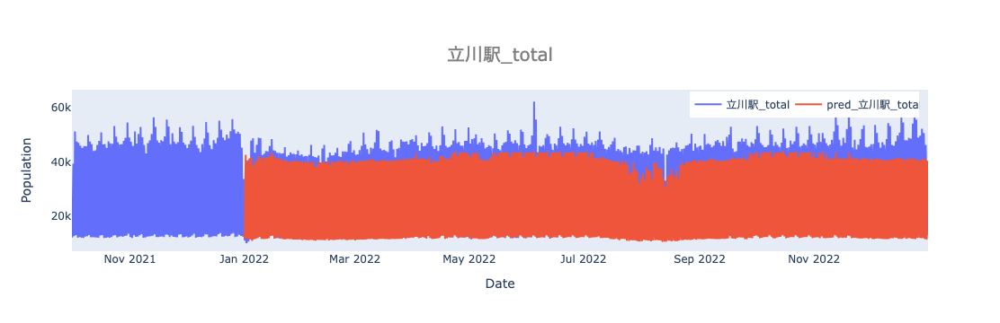

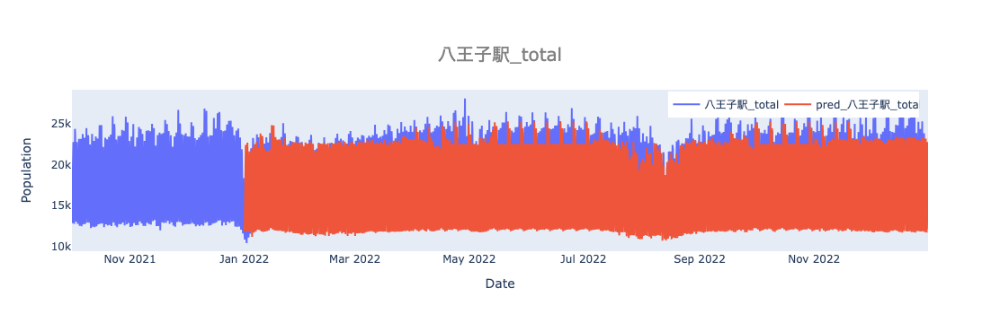

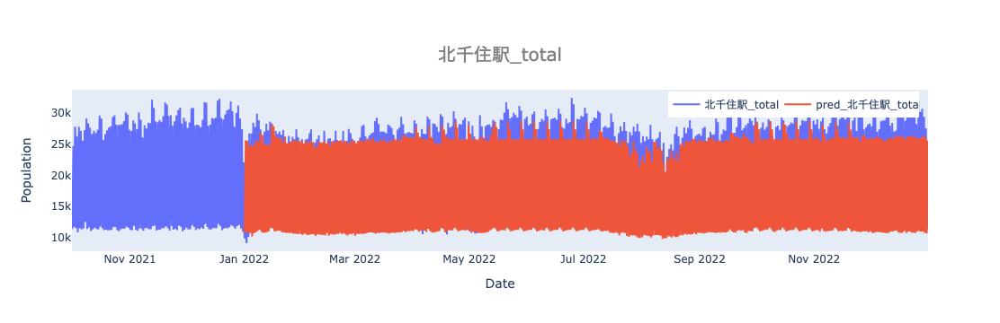

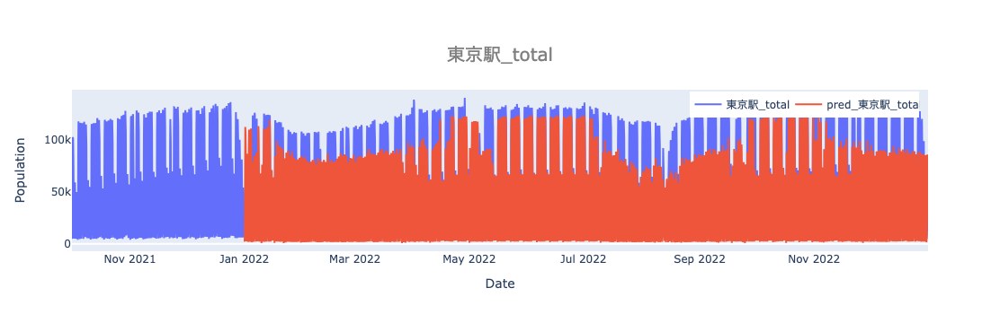

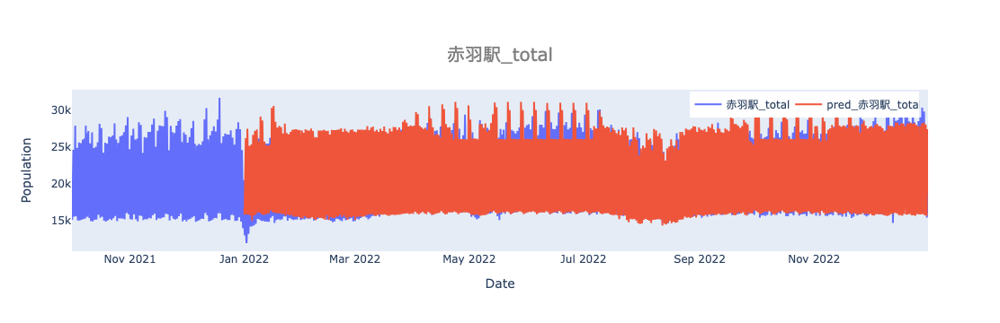

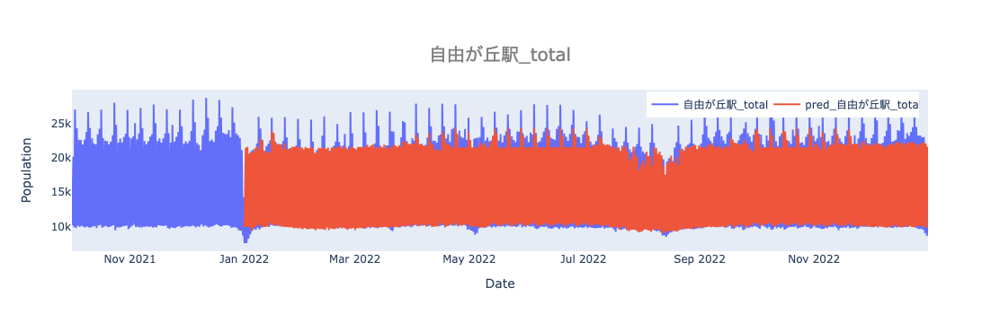

In [75]:
# make y_true df from a specific date
_df_train = df_train.loc['2021-10-01': ,:]
y_true_val = pd.concat([_df_train, df_valid]).iloc[:, :num_features_pred]
# y_true = df.loc['2021-10-01':valid_end, :].iloc[:, :num_features_pred]

plot_population(y_true_val, y_pred_val, flag='plot')

### Calculate RMSE and MAE (benchmark and actual values)

In [37]:
# df setup
num_features_pred = yaml_data['training']['num_features_pred']
df_bench_pred = pd.DataFrame([], columns=df.columns[:num_features_pred])
df_bench_true = pd.DataFrame([], columns=df.columns[:num_features_pred])

# month range and dow lists
bench_range = pd.date_range(start=valid_start, end=valid_end, freq='M')
dow_list = ['dow_Mon','dow_Tue','dow_Wed','dow_Thu','dow_Fri','dow_Sat', 'dow_Sun']

# get data from df_train/df_valid and compute mean
for month in bench_range:
    m = str(int(month.strftime('%m'))) # convert month to the same format as in df
    for dow in dow_list:
        query = f'month_{m} == 1 & {dow} == 1 & official_holiday == 0 & unofficial_holiday == 0' # month, dow, and non-holiday
        df_bench_pred.loc[month.strftime('%Y-%m') + ' ' + dow] = df_train.query(query).iloc[:, :num_features_pred].mean()
        df_bench_true.loc[month.strftime('%Y-%m') + ' ' + dow] = df_valid.query(query).iloc[:, :num_features_pred].mean()

# calculate RMSE and MAE
rmse, mae = {}, {}
for i in range(num_features_pred):
    rmse[df.columns[i][:-6]] = mean_squared_error(df_bench_pred.iloc[:, i], df_bench_true.iloc[:, i], squared=False)
    mae[df.columns[i][:-6]] = mean_absolute_error(df_bench_pred.iloc[:, i], df_bench_true.iloc[:, i])

rmse_ben_actu = pd.Series(rmse)
mae_ben_actu = pd.Series(mae)
print('------------RMSE------------')
print(rmse_ben_actu)
print('Average :', np.mean(rmse_ben_actu))
print('------------MAE-------------')
print(mae_ben_actu)
print('Average :', np.mean(mae_ben_actu))

UndefinedVariableError: name 'month_1' is not defined

### Anomaly detection for each location

In [30]:
def calc_anomaly_scores(matrix_valid, matrix_test):
    '''
    : calculate anomaly scores at each day by quadratic form
    : matrix_valid :  valid data for calculating mean and variance;  numpy matrix
    : matrix_test  :  predicted test data for getting anomaly scores;  numpy matrix
    : return       :  anomaly_scores; numpy array
    '''
    # compute mean and cov inverse
    mean = matrix_valid.mean(axis=0)
    cov_inv = np.matrix(np.cov(matrix_valid, rowvar=False)).getI()

    # apply quadratic formula to each row of matrix
    output = np.zeros(matrix_test.shape[0])
    for i in range(matrix_test.shape[0]):
        output[i] = ((matrix_test[i] - mean) * cov_inv * np.transpose(matrix_test[i] - mean)).item(0)

    return output


def get_anomaly_datetime(anomaly_scores, threshold):
    '''
    : get datetime when anomaly is detected
    : anomaly_scores    :  anomaly scores calculated from df_test;  numpy 1d array
    : threshold         :  threshold; float
    : return            :  anomaly_datetime, anomaly_next_hours; numpy array
    '''    
    # get df.index where anomaly_scores > threshold
    anomaly_datetime = df_test.index[anomaly_scores > threshold]
    print("num of anomaly-detected data", anomaly_datetime.shape[0])

    # get the next datetime when anomaly is detected
    anomaly_next_hours = []
    for date in anomaly_datetime:
        if date.hour == 18:  ##### Need to change manually #####
            anomaly_next_hours.append(date + datetime.timedelta(hours=15))
        else:
            anomaly_next_hours.append(date + datetime.timedelta(hours=3))
    
    return anomaly_datetime, anomaly_next_hours

In [31]:
# predict with test data
pred_test = predict(model = model, dataset = test_dataset_for_pred, num_features_pred = num_features_pred)
y_pred_test = pd.DataFrame(pred_test, columns=df.columns[:num_features_pred], index=df_test.index).add_prefix('pred_')

all_anomaly_datetime = []
all_anomaly_next_hours = []
for i in range(num_features_pred):
    # calculate anomaly score by using validation_data
    diff = df_valid.iloc[:, i].to_numpy() - pred_val[:, i] 
    anomaly_scores = np.abs(diff)
    # set top 1% score as threshold for test_data
    threshold = np.percentile(anomaly_scores, 99)
    print(f'{df.columns[i]} threshold:', threshold)

    # calculate anomaly_score for each location
    diff = df_test.iloc[:, i].to_numpy() - pred_test[:, i]
    anomaly_scores = np.abs(diff)
    # datetime when anomaly is detected
    anomaly_datetime, anomaly_next_hours = get_anomaly_datetime(anomaly_scores, threshold)
    
    all_anomaly_datetime.append(anomaly_datetime)
    all_anomaly_next_hours.append(anomaly_next_hours)
    print()

  0%|          | 0/273 [00:00<?, ?it/s]

渋谷駅_total threshold: 51511.77765625
num of anomaly-detected data 3

新宿駅_total threshold: 55924.8711328125
num of anomaly-detected data 7

町田駅_total threshold: 9326.003066406241
num of anomaly-detected data 30

川崎駅_total threshold: 10816.720703124998
num of anomaly-detected data 8

立川駅_total threshold: 15552.102539062493
num of anomaly-detected data 7

八王子駅_total threshold: 5685.202343749999
num of anomaly-detected data 8

北千住駅_total threshold: 7878.2305078124955
num of anomaly-detected data 10

東京駅_total threshold: 85292.66562499997
num of anomaly-detected data 21

赤羽駅_total threshold: 4977.234453124997
num of anomaly-detected data 28

自由が丘駅_total threshold: 5359.385390625
num of anomaly-detected data 13



  0%|          | 0/10 [00:00<?, ?it/s]

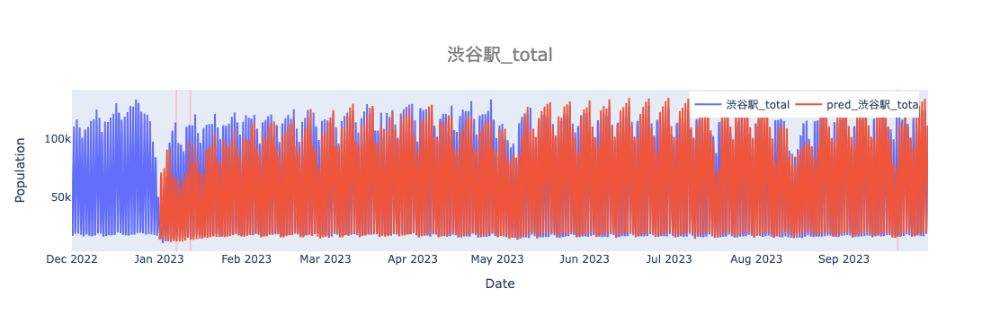

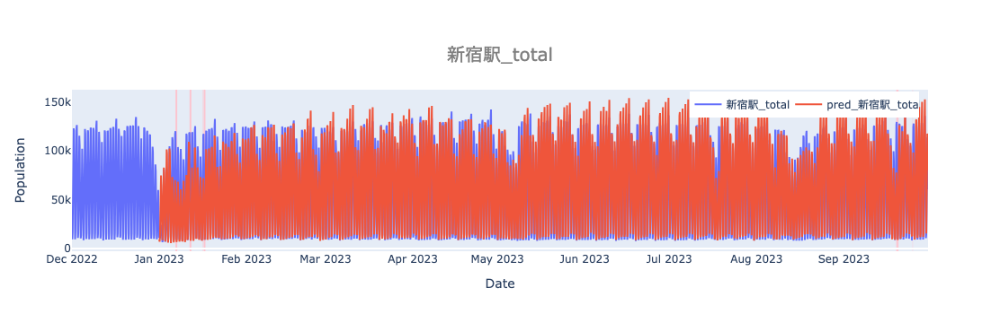

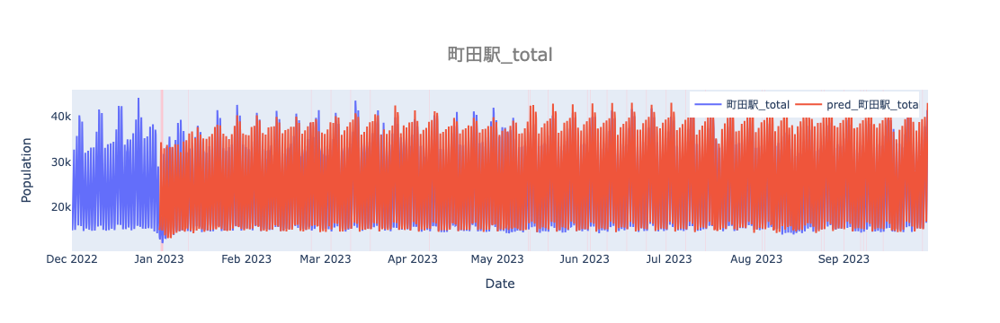

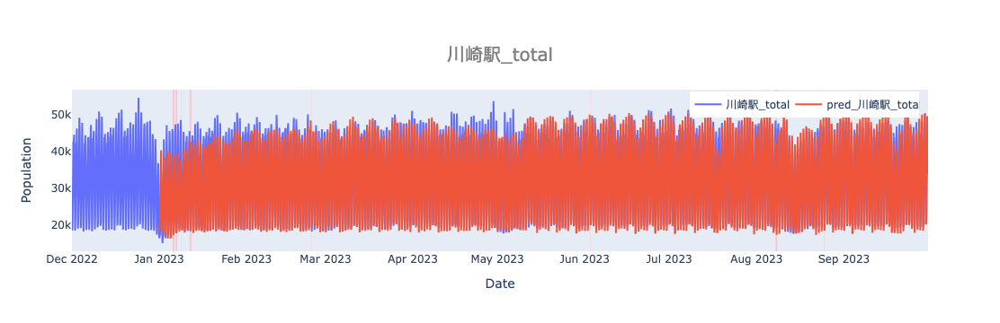

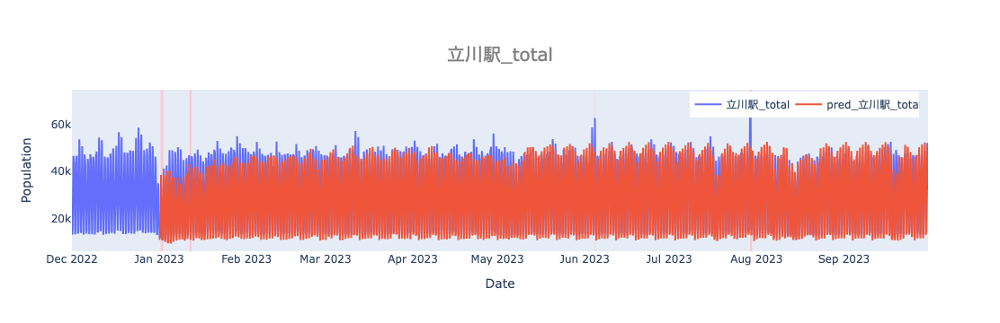

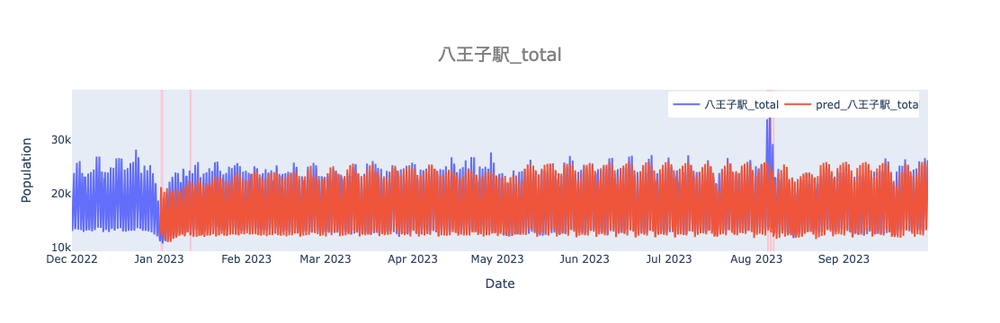

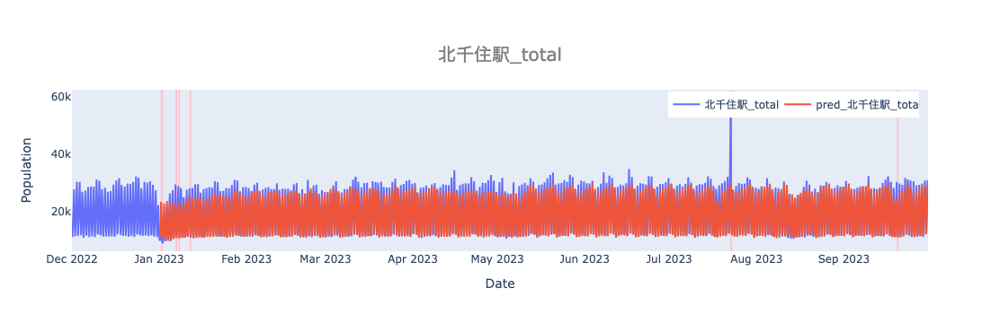

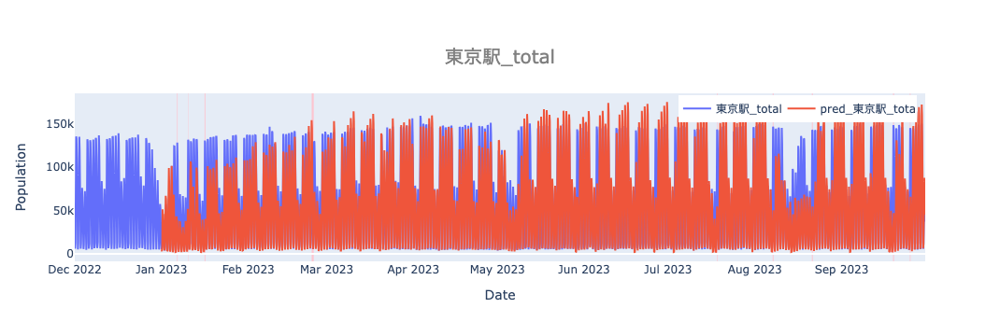

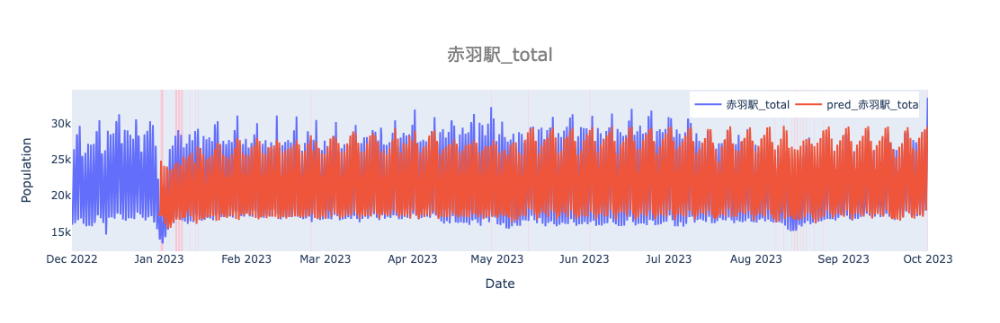

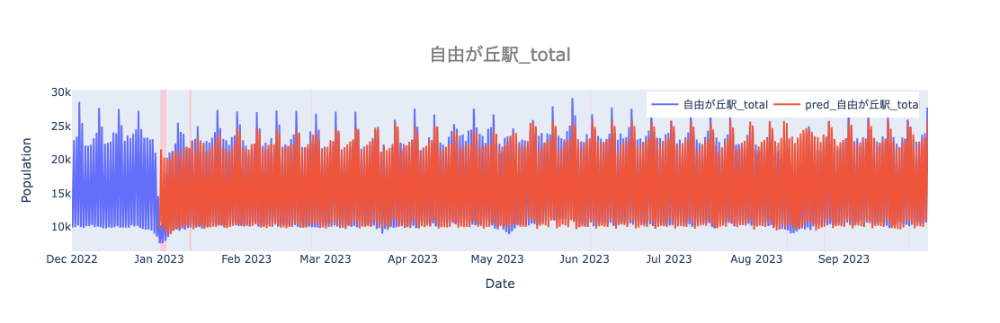

In [32]:
# make y_true df from a specific date
_df_valid = df_valid.loc['2022-12-01': ,:]
y_true_test = pd.concat([_df_valid, df_test]).iloc[:, :num_features_pred]

# plot
plot_population(y_true_test, y_pred_test, flag='anomaly_detection', 
                anomaly_datetime=all_anomaly_datetime, anomaly_next_hours=all_anomaly_next_hours)

### Anomaly detection for Tokyo

In [33]:
# predict with test data
pred = predict(model = model, dataset = test_dataset_for_pred, num_features_pred = num_features_pred)
y_pred_test = pd.DataFrame(pred_test, columns=df.columns[:num_features_pred], index=df_test.index).add_prefix('pred_')

# calculate anomaly score by using validation_data
anomaly_scores = calc_anomaly_scores(np.matrix(df_valid.iloc[:,:num_features_pred]), np.matrix(y_pred_val))
# set top 1% score as threshold for test_data
threshold = np.percentile(anomaly_scores, 99)
print('threshold:', threshold)

# calculate anomaly_score for whole Tokyo
anomaly_scores = calc_anomaly_scores(np.matrix(df_valid.iloc[:,:num_features_pred]), np.matrix(y_pred_test)) 
# datetime when anomaly is detected
anomaly_datetime, anomaly_next_hours = get_anomaly_datetime(anomaly_scores, threshold)

  0%|          | 0/273 [00:00<?, ?it/s]

threshold: 31.49701335998806
num of anomaly-detected data 504


  0%|          | 0/10 [00:00<?, ?it/s]

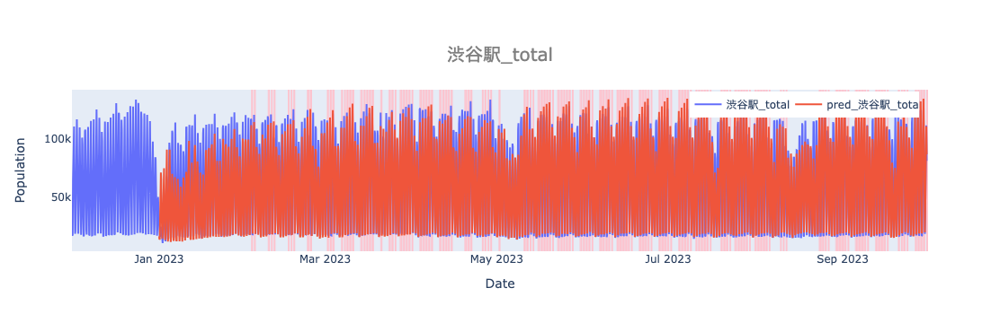

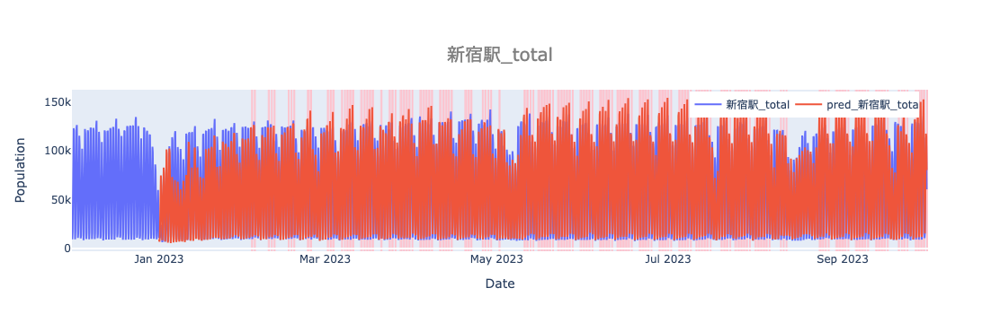

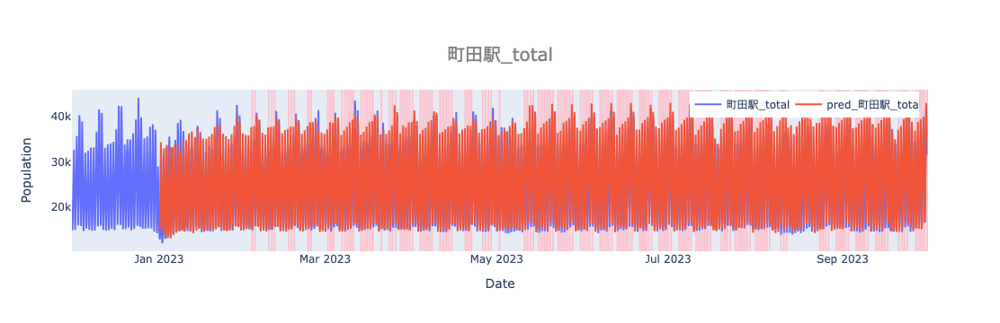

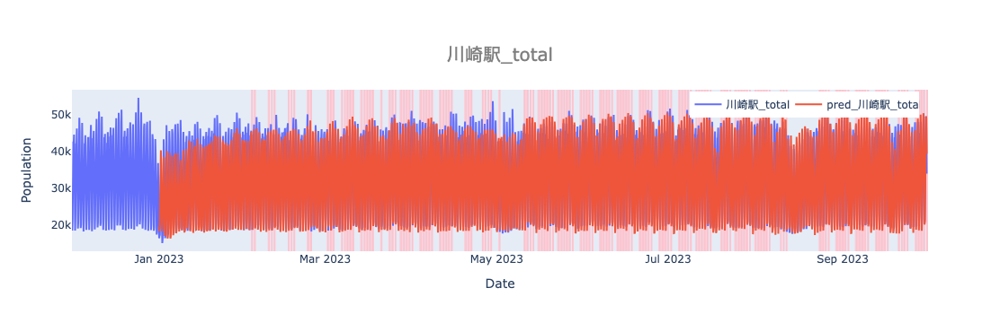

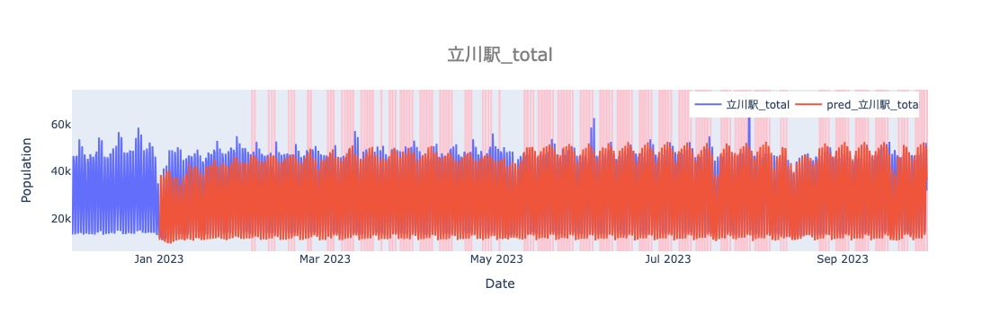

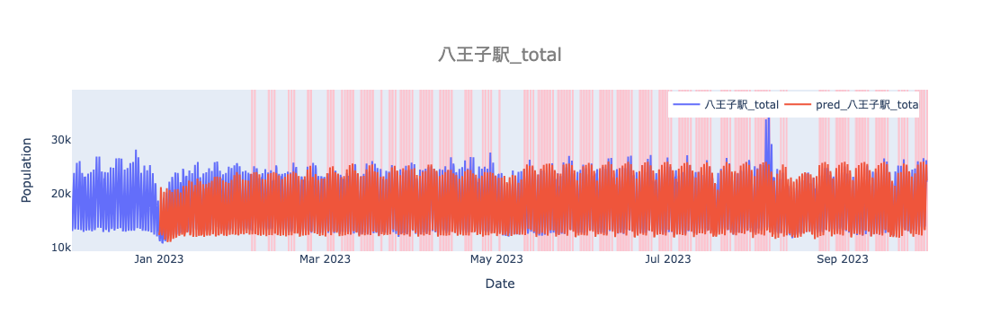

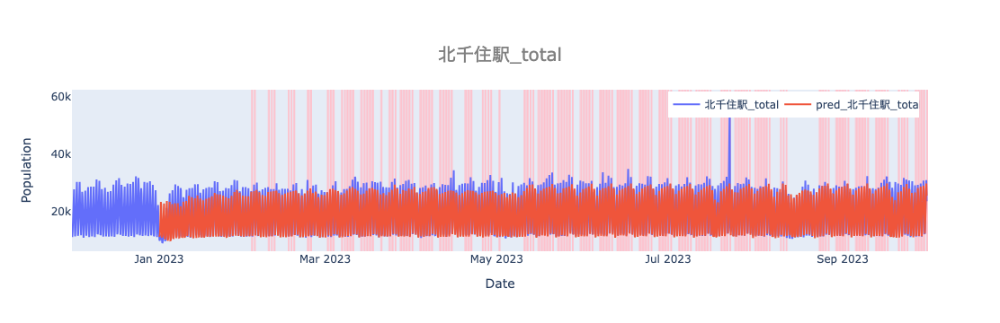

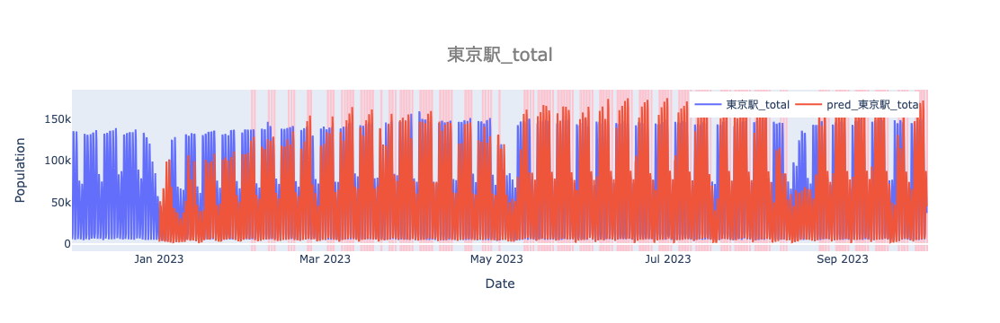

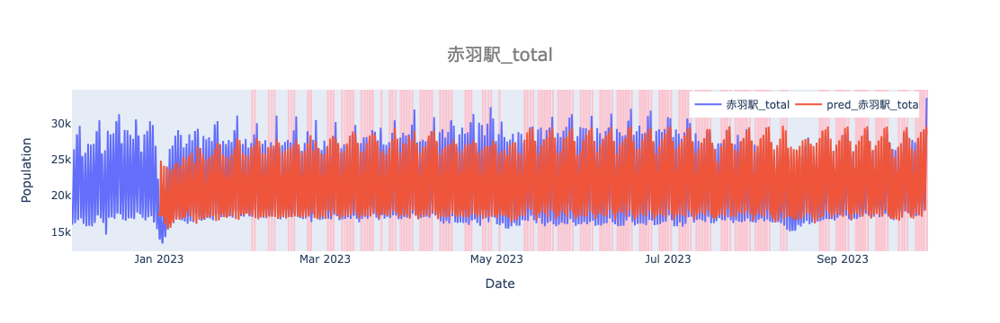

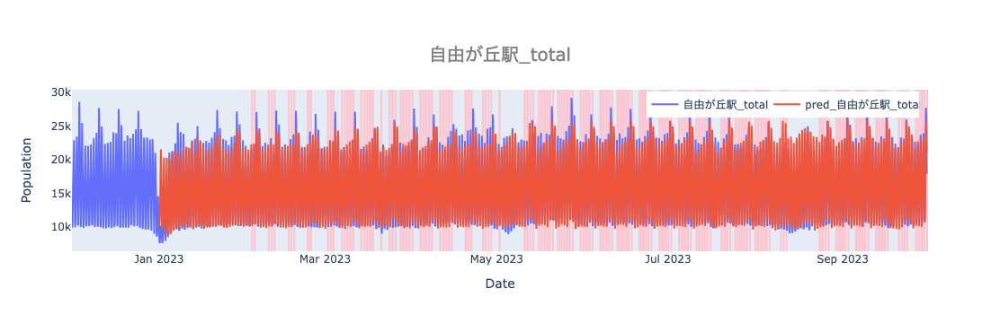

In [34]:
# make y_true df from a specific date
_df_valid = df_valid.loc['2022-12-01': ,:]
y_true_test = pd.concat([_df_valid, df_test]).iloc[:, :num_features_pred]

# plot
plot_population(y_true_test, y_pred_test, flag='anomaly_detection_tokyo', 
                anomaly_datetime=anomaly_datetime, anomaly_next_hours=anomaly_next_hours)

### Save the results and the model 

In [76]:
rmse_ben_actu = 0.0
mae_ben_actu = 0.0

In [77]:
'''
save the model, its loss, and params used
'''
# count the number of files in the directory
path = '/Users/koki/PycharmProjects/MasterThesis/models'

# read parameter data
df1 = pd.read_excel('/Users/koki/PycharmProjects/MasterThesis/data/results.xlsx', sheet_name='params')

# set a model name
num = 'model_' + str(df1.shape[0]+1).zfill(2)

# get params used in this file
series = pd.concat([pd.Series(yaml_data['dataset']), pd.Series(yaml_data['model']), pd.Series(yaml_data['training'])])
params = pd.DataFrame(series).T
params.insert(0, "num", num)
params.insert(1, "file_name", "LSTM_seq2seq_ver9")  ###### the name of this file! ######
params.insert(2, "date_of_execution", datetime.datetime.today().strftime("%Y-%m-%d %H:%M"))
params.insert(3, "execution_time", elapsed_time)
params.insert(params.shape[1], "final_train_loss" , math.floor(train_losses[-1]))
params.insert(params.shape[1], "rmse_pred_actu" , math.floor(np.mean(rmse_pre_actu)))
params.insert(params.shape[1], "mae_pred_actu" , math.floor(np.mean(mae_pre_actu)))
params.insert(params.shape[1], "rmse_ben_actu" , math.floor(np.mean(rmse_ben_actu)))
params.insert(params.shape[1], "mae_ben_actu" , math.floor(np.mean(mae_ben_actu)))
df1 = pd.concat([df1, params])

# read loss data
df2 = pd.read_excel('/Users/koki/PycharmProjects/MasterThesis/data/results.xlsx', sheet_name='train_losses')
df2 = pd.concat([df2, pd.Series(train_losses, name=num)], axis=1)

# export the data 
with pd.ExcelWriter('/Users/koki/PycharmProjects/MasterThesis/data/results.xlsx') as writer:
    df1.to_excel(writer, sheet_name='params', index=False)
    df2.to_excel(writer, sheet_name='train_losses', index=False)

# save the model
torch.save(model, '/Users/koki/PycharmProjects/MasterThesis/models/' + num + '.pth')

In [36]:
# notification
# !afplay '/Users/koki/Documents/セレナと一緒/result_message.m4a'

In [37]:
print('Done!')

Done!


### Memo

In [38]:
'''
再帰的に予測する際、t+1期のインプットには、t期の人流のアウトプット（t+1期の人流の予測値）＋t+1期の実際のダミー情報（t期からアウトプットされた予測ではなく本当のデータ）を利用する。
    →例えば曜日などは予測しなくてもわかるはずなので、わざわざ再帰的に予測値をインプットする必要がない
    
学習には3時間おきのデータを利用。昼間だけを使うのは予測の時だけ。    
'''

'\n再帰的に予測する際、t+1期のインプットには、t期の人流のアウトプット（t+1期の人流の予測値）＋t+1期の実際のダミー情報（t期からアウトプットされた予測ではなく本当のデータ）を利用する。\n    →例えば曜日などは予測しなくてもわかるはずなので、わざわざ再帰的に予測値をインプットする必要がない\n    \n学習には3時間おきのデータを利用。昼間だけを使うのは予測の時だけ。    \n'

### Questions

In [39]:
'''
seq2seqの推論時、decoderは前期の出力を入力して、再起的にループさせる。それは学習時も同じ？
 - no
 
単純なlstmは、出力が一期先のみ。targetが複数期先にして学習する時は、学習時もループさせるの？
もしそうなら、targetも複数期ある意味は？それってseq_len_src=8, seq_len_tgt=1のデータセットで学習するのと同じじゃない？
 - no

ベンチマークは、機械学習を使わなかったらどういう予測になるかを見るため？もしそうならベンチマークと比べるのは実測値？
 - yes.

バグの原因は、ミニバッチでpredictしていたからだった。ミニバッチにして一気に予測しようとしていたけど、一気にencoderに入れるとencoderの出力が変わっちゃう？
 - 何でだろうね

閾値の決め方は？
 - validatonでも異常検知を行なって、大きい順にした時の上位1%の異常スコアを閾値にする。
 
モデルについて
 - lstｍには全変数を入力する。線型結合層は2層以上にしても良い。でもその時はreluに通して非線形にする。

東京全体で異常検知した日を各地点ごとのグラフで表すのは正しいのか？
 -  

各地点それぞれで異常検知を行う場合は？

'''

'\nseq2seqの推論時、decoderは前期の出力を入力して、再起的にループさせる。それは学習時も同じ？\n - no\n \n単純なlstmは、出力が一期先のみ。targetが複数期先にして学習する時は、学習時もループさせるの？\nもしそうなら、targetも複数期ある意味は？それってseq_len_src=8, seq_len_tgt=1のデータセットで学習するのと同じじゃない？\n - no\n\nベンチマークは、機械学習を使わなかったらどういう予測になるかを見るため？もしそうならベンチマークと比べるのは実測値？\n - yes.\n\nバグの原因は、ミニバッチでpredictしていたからだった。ミニバッチにして一気に予測しようとしていたけど、一気にencoderに入れるとencoderの出力が変わっちゃう？\n - 何でだろうね\n\n閾値の決め方は？\n - validatonでも異常検知を行なって、大きい順にした時の上位1%の異常スコアを閾値にする。\n \nモデルについて\n - lstｍには全変数を入力する。線型結合層は2層以上にしても良い。でもその時はreluに通して非線形にする。\n\n東京全体で異常検知した日を各地点ごとのグラフで表すのは正しいのか？\n -  \n\n\n'

### Insight

In [40]:
'''
バッチサイズは16くらいが良い。それ以上だとロスがすごく大きい値で収束する。

'''

'\nバッチサイズは16くらいが良い。それ以上だとロスがすごく大きい値で収束する。\n\n'

### To Do

In [41]:
'''
時間ダミーと月ダミーを抜く
encoderは2日にする
差を計算する
時間を多次元とみて計算
'''

'\n'